## Лабораторная работа № 2. Exploratory Data Analysis и линейная регрессия


### О задании
В этом задании мы попытаемся научиться анализировать данные и выделять из них полезные признаки. Мы также научимся пользоваться `seaborn` и `sklearn`, а заодно привыкнем к основным понятиям машинного обучения.

В этом ноутбуке используется библиотека `folium` для визуализации карт. Она работает в google colab!

In [2]:
import folium

m = folium.Map(location=(55.7522200, 37.6155600), zoom_start=10)

m

Если вы всё сделали правильно, то выше должна открыться карта Москвы.

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

sns.set(style="darkgrid")

## Часть 0. Подготовка

**Задание 1**. Мы будем работать с данными из соревнования [New York City Taxi Trip Duration](https://www.kaggle.com/c/nyc-taxi-trip-duration/overview), в котором нужно было предсказать длительность поездки на такси. Скачайте обучающую выборку из этого соревнования и загрузите ее:

In [4]:
data=pd.read_csv('train.csv')
data.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435


Обратите внимание на колонки `pickup_datetime` и `dropoff_datetime`.    `dropoff_datetime` был добавлена организаторами только в обучающую выборку, то есть использовать эту колонку нельзя, давайте удалим ее. В `pickup_datetime` записаны дата и время начала поездки. Чтобы с ней было удобно работать, давайте преобразуем даты в `datetime`-объекты

In [5]:
data.dtypes
data.drop('dropoff_datetime',axis=1, inplace=True)
data['pickup_datetime'] = pd.to_datetime(data['pickup_datetime'])
data.dtypes

id                            object
vendor_id                      int64
pickup_datetime       datetime64[ns]
passenger_count                int64
pickup_longitude             float64
pickup_latitude              float64
dropoff_longitude            float64
dropoff_latitude             float64
store_and_fwd_flag            object
trip_duration                  int64
dtype: object

В колонке `trip_duration` записано целевое значение, которое мы хотим предсказывать. Давайте посмотрим на распределение таргета в обучающей выборке. Для этого нарисуйте его гистограмму:

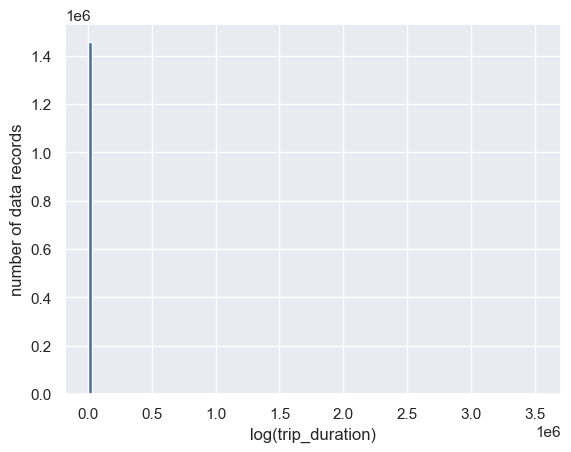

In [6]:
data['log_trip_duration'] = data['trip_duration'].values 
plt.hist(data['log_trip_duration'].values, bins=100)
plt.xlabel('log(trip_duration)')
plt.ylabel('number of data records')
plt.show()

**Вопрос**: Что можно сказать о целевой переменной по гистограмме её значений?

Логарифмическое преобразование продолжительности поездки приводит к нормальному распределению. Время большей части поездкок составляет от 54 секунд $e^4$ до 2980 секунд $e^8 $ . Это указывает на то, что большинство поездок совершаются в течение одного часа. Но есть поездки, которые длятся меньше минуты, а также есть поездки продолжительностью 100 часов, что странно, поскольку поездки на такси осуществляются в пределах Нью-Йорка. 

В соревновании в качестве метрики качества использовалось RMSLE:
$$\text{RMSLE}(X, y, a) = \sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\log{(y_i + 1)} - \log{(a(x_i) + 1)}\big)^2}$$

**Вопрос**: Как вы думаете, почему авторы соревнования выбрали именно RMSLE, а не RMSE?

В пользу выбора RMSLE можно выделить три фактора:
- Использование логарифма позволяет сгладить различия между большими и маленькими значениями. В задачах, связанных с длительностью поездок, наблюдается широкий диапазон значений - от нескольких секунд до нескольких часов. Логарифмическое преобразование может помочь сделать распределение более нормальным и уменьшить влияние крайних значений на оценку модели.

- RMSLE может быть полезным в случаях, когда ошибки модели в большую сторону более значимы, чем ошибки в меньшую сторону. Например, если модель предсказывает длительность поездки в 30 минут, а фактическая длительность составляет 60 минут, это может считаться более серьезной ошибкой, чем если модель предсказывает 90 минут вместо 60 минут. RMSLE может частично учесть такое поведение.

- В некоторых случаях, особенно когда задача имеет бизнес-ориентированный контекст, логарифмические метрики могут быть более интерпретируемыми. Например, вместо сообщения об ошибке в секундах или минутах, RMSLE может быть представлено в виде процента или иного сопоставимого показателя, что может быть более понятным для бизнес-аналитиков или заинтересованных сторон.

На семинаре мы рассматривали несколько моделей линейной регрессии в `sklearn`, но каждая из них оптимизировала среднеквадратичную ошибку (MSE), а не RMSLE. Давайте проделаем следующий трюк: будем предсказывать не целевую переменную, а ее *логарифм*. Обозначим $\hat{y}_i = \log{(y_i + 1)}$ — модифицированный таргет, а $\hat{a}(x_i)$ — предсказание модели, которая обучалась на $\hat{y}_i$, то есть логарифм таргета. Чтобы предсказать исходное значение, мы можем просто взять экспоненту от нашего предсказания: $a(x_i) = \exp(\hat{a}(x_i)) - 1$.

**Вопрос**: Покажите, что оптимизация RMSLE для модели $a$ эквивалентна оптимизации MSE для модели $\hat{a}$.

**Доказательство**:
Пусть $\hat{y}$ - модифицированный таргет, а $y$ - исходный таргет. Тогда:

$$\hat{y} = log(y+1)$$

Мы хотим предсказывать исходное значение $y$ с помощью модели $a(x)$, обученной на модифицированном таргете $\hat{y}$. Предсказание модели $a(x)$, используя модифицированный таргет, будет выглядеть следующим образом:

$$\hat{a}(x) = a(x)$$

Теперь, чтобы показать эквивалентность оптимизации RMSLE для модели $a$ и оптимизации MSE для модели $\hat{a}$, рассмотрим их выражения.

1. Оптимизация RMSLE для модели $a$:

$$\text{RMSLE}(X, y, a) = \sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\log{(y_i + 1)} - \log{(a(x_i) + 1)}\big)^2}$$

2. Оптимизация MSE для модели $\hat{a}$:

$$\text{MSE}{(X,y,a)} = \frac{1}{n}\sum_{i=1}^{n}\big(y_i-a_i)^2$$

Теперь учтем, что:
$$\log{(a(x) + 1)} = \log{(\exp(\hat{a}(x)) - 1 + 1)} = \log{(\exp(\hat{a}(x)))} = \hat{a}(x)$$
$$\log{(y_i + 1)} = \log{(\exp(\hat{y_i}) - 1 + 1)} = \log{(\exp(\hat{y_i}))} = \hat{y_i}$$

Подставим это обратно в выражение RMSLE:
$$\text{RMSLE}(X, y, a) = \sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\log{(\exp(y_i) - 1 + 1)} - \log{(\exp(a(x)) - 1 + 1)}\big)^2} = \sqrt{\frac{1}{n}\sum_{i=1}^{n}\big(y_i-a_i)^2} = \sqrt{MSE(X,y,a)}$$

Из этого следует, что RMSE и MSE эквивалентны. RMSE является просто квадратным корнем из MSE и оба показателя оценивают среднеквадратичную ошибку между истинными и предсказанными значениями.

Итак, мы смогли свести задачу оптимизации RMSLE к задаче оптимизации MSE, которую мы умеем решать! Кроме того, у логарифмирования таргета есть еще одно полезное свойство. Чтобы его увидеть, добавьте к нашей выборке колонку `log_trip_duration` (воспользуйтесь `np.log1p`) и нарисуйте гистограмму модифицированного таргета по обучающей выборке. Удалите колонку со старым таргетом.

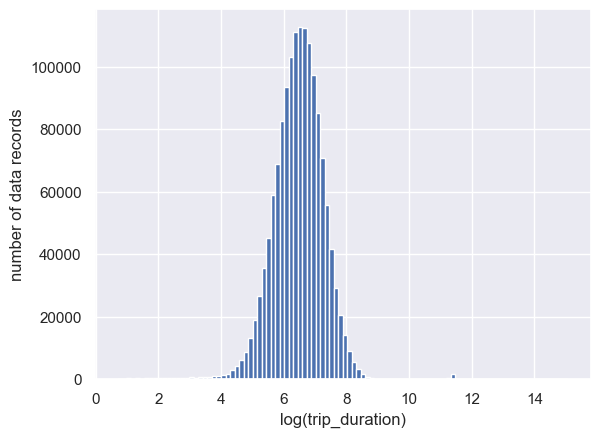

In [7]:
data['log_trip_duration'] = np.log1p(data['trip_duration'].values)
trip_duration = data['trip_duration']
data.drop('trip_duration',axis=1, inplace=True)
plt.hist(data['log_trip_duration'].values, bins=100)
plt.xlabel('log(trip_duration)')
plt.ylabel('number of data records')
plt.show()

Чтобы иметь некоторую точку отсчета, давайте посчитаем значение метрики при наилучшем константном предсказании:

In [8]:
from sklearn.metrics import mean_squared_log_error
rmsle = np.sqrt(np.sum((data['log_trip_duration'] - data['log_trip_duration'].mean())**2)/len(data))
print("RMSLE:", rmsle)

RMSLE: 0.7957592365411509


## Часть 1. Изучаем `pickup_datetime`

**Задание 2**. Для начала давайте посмотрим, сколько всего было поездок в каждый из дней. Постройте график зависимости количества поездок от дня в году (например, можно воспользоваться `sns.countplot`):

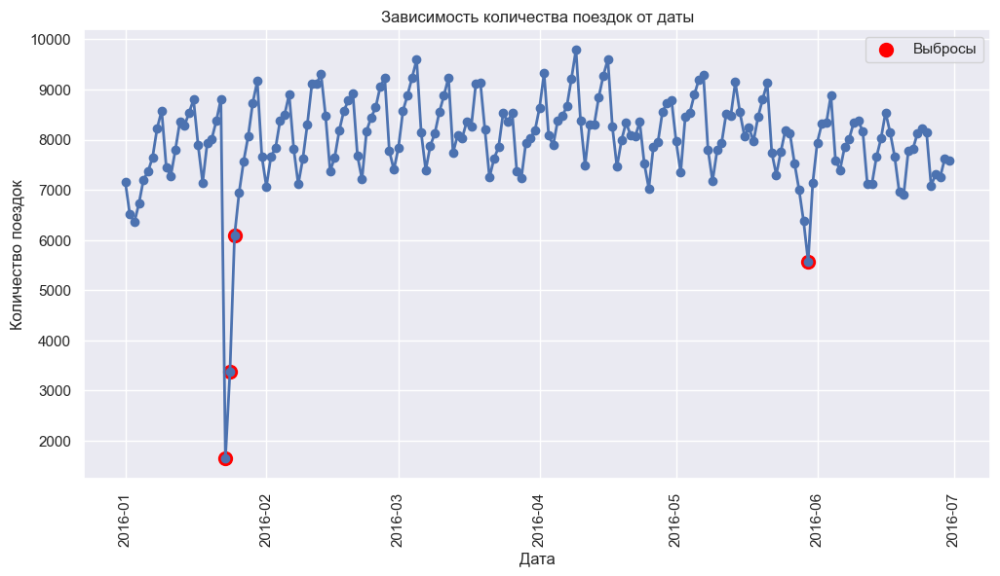

In [9]:
# Подсчет количества поездок по датам
rides_per_day = data.groupby(data['pickup_datetime'].dt.date).size()

# Вычисление границ выбросов
Q1 = rides_per_day.quantile(0.25)
Q3 = rides_per_day.quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Пометка дат с выбросами
outliers = rides_per_day[(rides_per_day < lower_bound) | (rides_per_day > upper_bound)]
outlier_dates = outliers.index

# Построение графика с соединенными линиями и выделением выбросов
plt.figure(figsize=(12, 6))
plt.plot(rides_per_day.index, rides_per_day.values, marker='o', linestyle='-', linewidth=2)
plt.title('Зависимость количества поездок от даты')
plt.xlabel('Дата')
plt.ylabel('Количество поездок')
plt.xticks(rotation=90)
plt.grid(True)
plt.scatter(outlier_dates, outliers.values, color='red', marker='o', label='Выбросы',s=100)
plt.legend()
plt.show()



**Вопрос**: Вы, вероятно, заметили, что на графике есть 2 периода с аномально маленькими количествами поездок. Вычислите, в какие даты происходили эти скачки вниз и найдите информацию о том, что происходило в эти дни в Нью-Йорке.


In [10]:
outlier_dates = outliers.index.tolist()
print(outlier_dates)

[datetime.date(2016, 1, 23), datetime.date(2016, 1, 24), datetime.date(2016, 1, 25), datetime.date(2016, 5, 30)]


- 23.01.2016 25-01-2016: Власти запретили автомобильное движение в Нью-Йорке из-за снежной бури

- 30.05.2016: День Поминовения (англ. Memorial Day) — национальный день памяти США

Нарисуйте графики зависимости количества поездок от дня недели и от часов в сутках (воспользуйтесь `sns.relplot`):

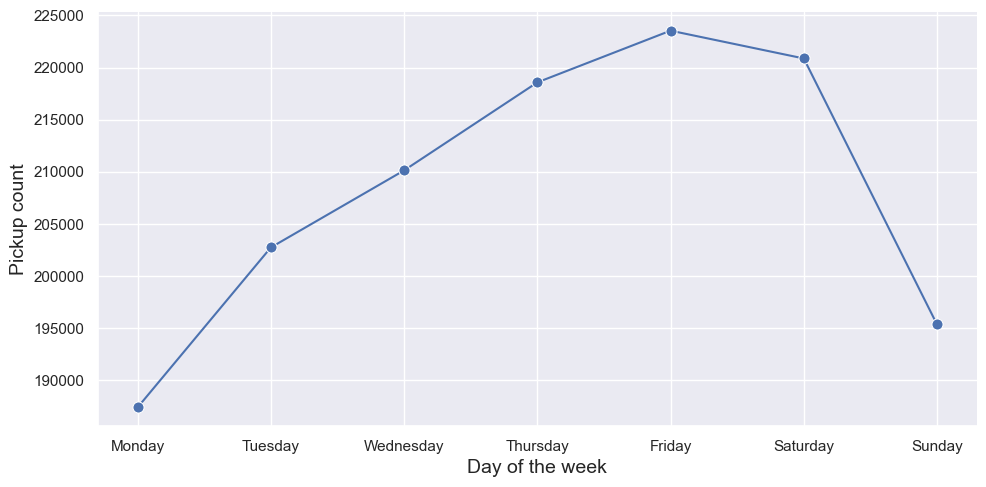

In [11]:

# Создание столбца с днем недели
data['pickup_weekday'] = data['pickup_datetime'].dt.weekday

# Подсчет количества поездок по дням недели
rides_per_weekday = data.groupby('pickup_weekday').size().reset_index(name='count')

# Построение графика зависимости количества поездок от дня недели
sns.relplot(x='pickup_weekday', y='count', kind='line', data=rides_per_weekday, marker='o', markersize=8, linestyle='-', height=5, aspect=2)

# Настройка осей и меток
plt.xlabel('Day of the week', fontsize=14)
plt.ylabel('Pickup count', fontsize=14)
plt.xticks(range(7), ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

# Отображение графика
plt.show()

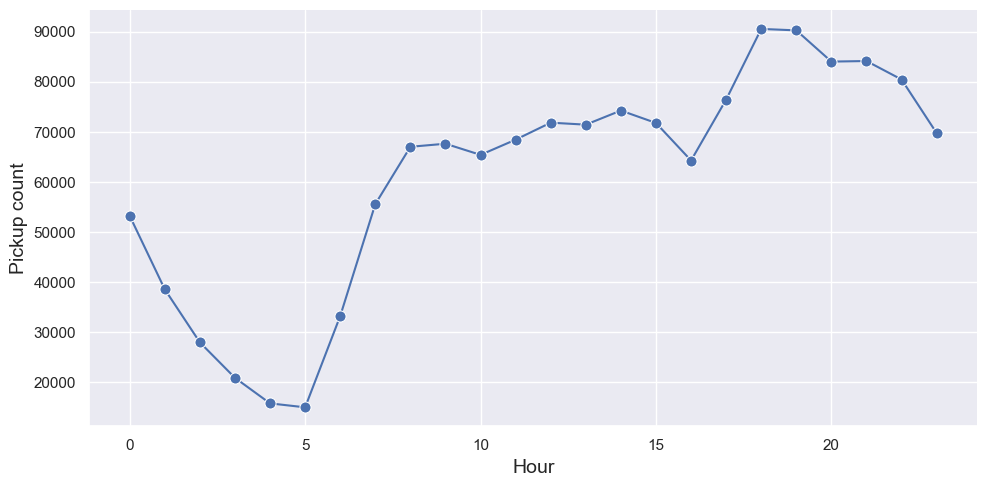

In [12]:
data['pickup_hour'] = data['pickup_datetime'].dt.hour

# Подсчет количества поездок по часам
rides_per_hour = data.groupby('pickup_hour').size().reset_index(name='count')

# Построение графика зависимости количества поездок от часа в сутках
sns.relplot(x='pickup_hour', y='count', kind='line', data=rides_per_hour, marker='o', markersize=8, linestyle='-', height=5, aspect=2)

# Настройка осей и меток
plt.xlabel('Hour', fontsize=14)
plt.ylabel('Pickup count', fontsize=14)

# Отображение графика
plt.show()

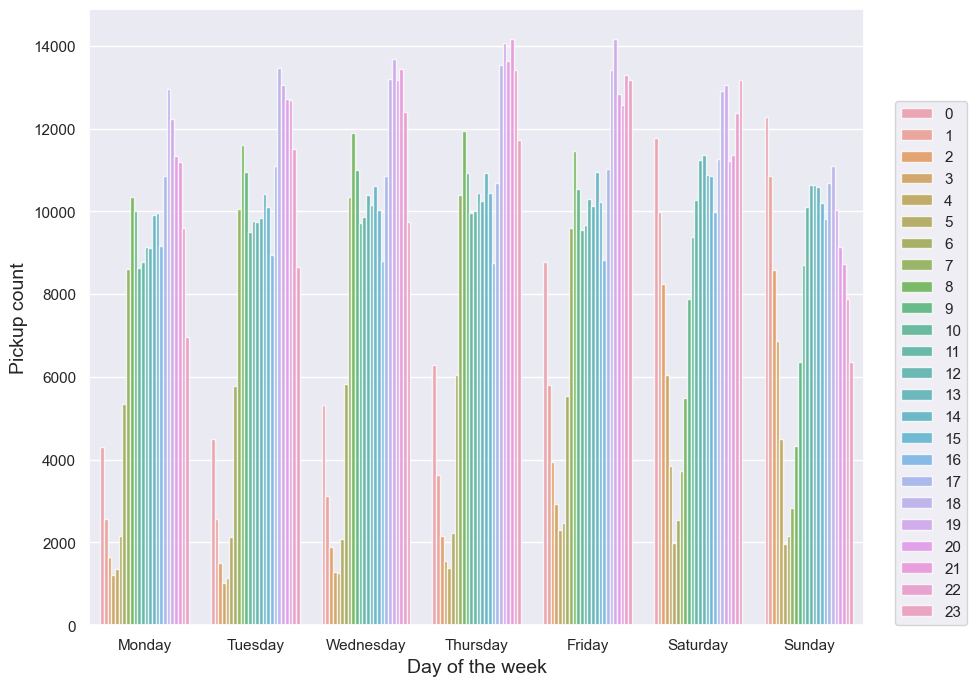

In [13]:
f = plt.figure(figsize=(10,8))
days = [i for i in range(7)]
sns.countplot(x='pickup_weekday', data=data, hue='pickup_hour', alpha=0.8)
plt.xlabel('Day of the week', fontsize=14)
plt.ylabel('Pickup count', fontsize=14)
plt.xticks(days, ('Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'))
plt.legend(loc=(1.04,0))
plt.show()

**Задание 3**. Нарисуйте на одном графике зависимости количества поездок от часа в сутках для разных месяцев (разные кривые, соответствующие разным месяцам, окрашивайте в разные цвета, воспользуйтесь `hue` в `sns.relplot`). Аналогично нарисуйте зависимости количества поездок от часа в сутках для разных дней недели.

<Figure size 800x600 with 0 Axes>

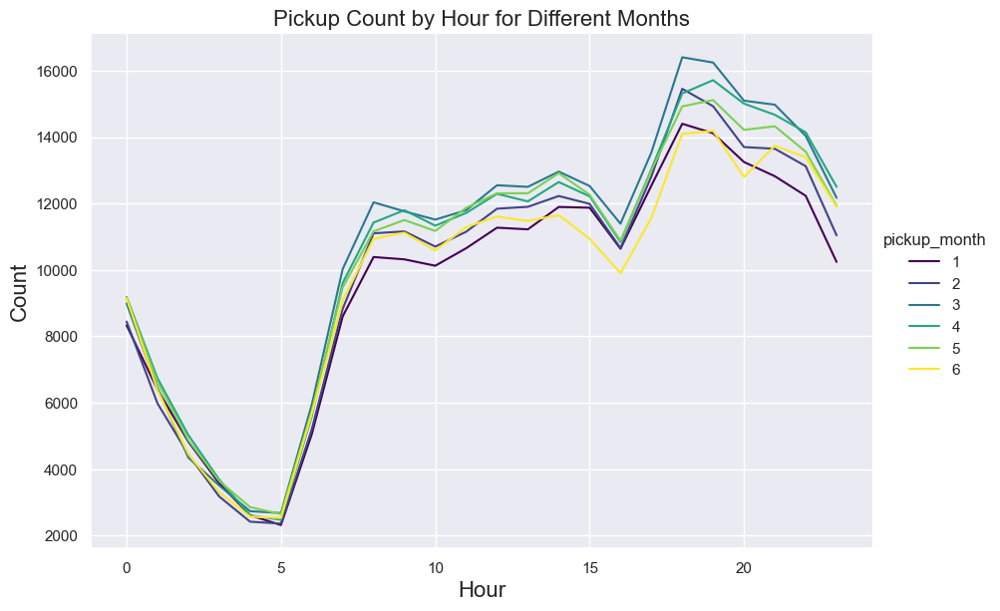

In [14]:
data['pickup_month'] = data.pickup_datetime.dt.month

month_count = data.groupby(['pickup_hour', 'pickup_month'], as_index=False).count()[['pickup_hour', 'pickup_month', 'id']]

plt.figure(figsize=(8, 6))
sns.relplot(x='pickup_hour', y='id', data=month_count, kind='line', hue='pickup_month', palette='viridis', height=6, aspect=1.5)

plt.xlabel('Hour', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.title('Pickup Count by Hour for Different Months', fontsize=16)

plt.show()


**Вопрос**: Какие выводы можно сделать, основываясь на графиках выше? Выделяются ли какие-нибудь дни недели? Месяца? Время суток? С чем это связано?
 - Продолжительность поездки наибольшая в четверг, пятницу и субботу и наименьшая в воскресенье, в принципе звучит достаточно логично, последний выходной дома.
 - Наибольшая продолжительность поездки приходится на период с 11:00 до 16:00, а наименьшая - с 04:00 до 07:00. Естественным образом вытекает из режима сна.

**Задание 4**. Разбейте выборку на обучающую и тестовую в отношении 7:3. По обучающей выборке нарисуйте график зависимости среднего логарифма времени поездки от дня недели. Затем сделайте то же самое, но для часа в сутках и дня в году.

In [15]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(data.drop('log_trip_duration',axis=1), data[['id','log_trip_duration']], test_size=0.3, random_state=42)
print(len(X_test)/len(X_train)) # как раз получаем 3:7

0.4285725478673914


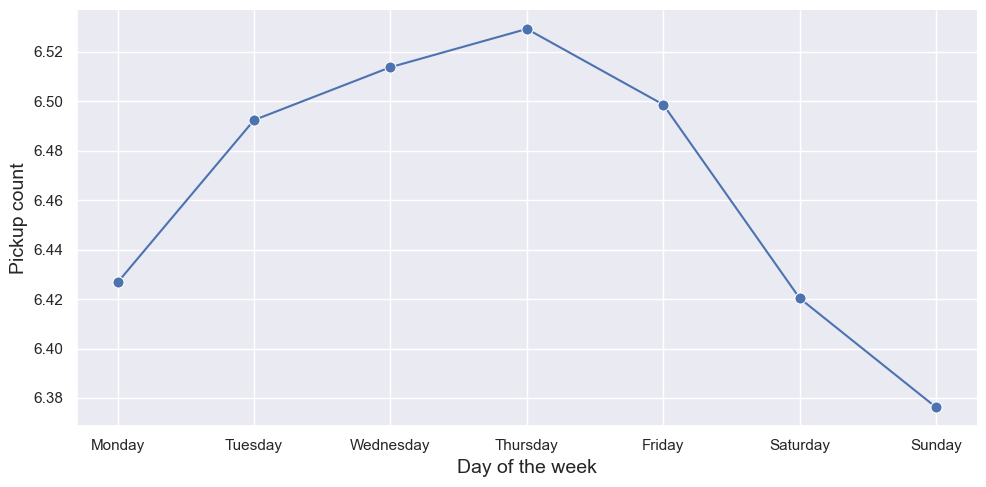

In [16]:
Train = pd.merge(X_train, y_train, on='id')


mean_log_duration = Train.groupby('pickup_weekday')['log_trip_duration'].mean()


# Создание столбца с днем недели
Train['pickup_weekday'] = Train['pickup_datetime'].dt.weekday

# Подсчет количества поездок по дням недели
rides_per_weekday = Train.groupby('pickup_weekday').size().reset_index(name='count')

# Построение графика зависимости количества поездок от дня недели
sns.relplot(x=mean_log_duration.index, y=mean_log_duration.values, kind='line', data=rides_per_weekday, marker='o', markersize=8, linestyle='-', height=5, aspect=2)

# Настройка осей и меток
plt.xlabel('Day of the week', fontsize=14)
plt.ylabel('Pickup count', fontsize=14)
plt.xticks(range(7), ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

# Отображение графика
plt.show()


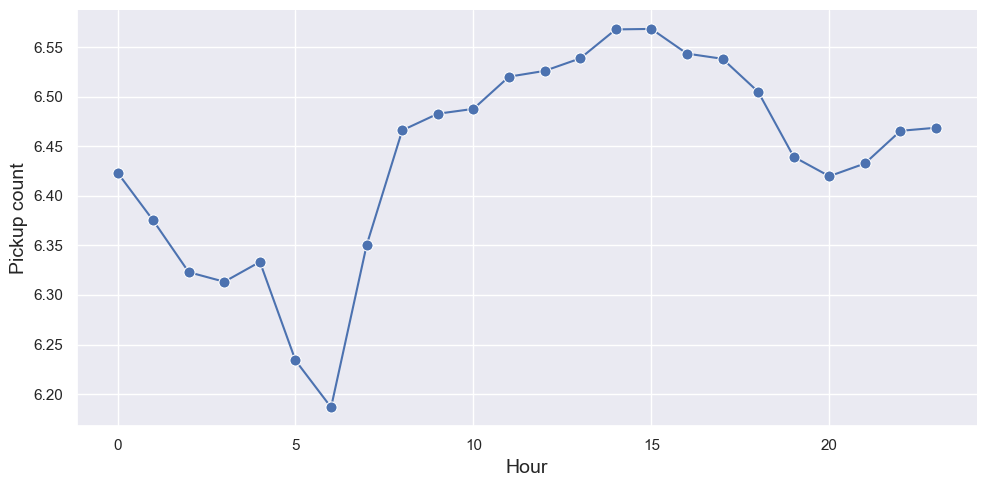

In [17]:
Train['pickup_hour'] = Train['pickup_datetime'].dt.hour

# Подсчет количества поездок по часам
mean_log_duration_hour = Train.groupby('pickup_hour')['log_trip_duration'].mean()

# Построение графика зависимости количества поездок от часа в сутках
sns.relplot(x=mean_log_duration_hour.index, y=mean_log_duration_hour.values, kind='line', data=rides_per_hour, marker='o', markersize=8, linestyle='-', height=5, aspect=2)

# Настройка осей и меток
plt.xlabel('Hour', fontsize=14)
plt.ylabel('Pickup count', fontsize=14)

# Отображение графика
plt.show()



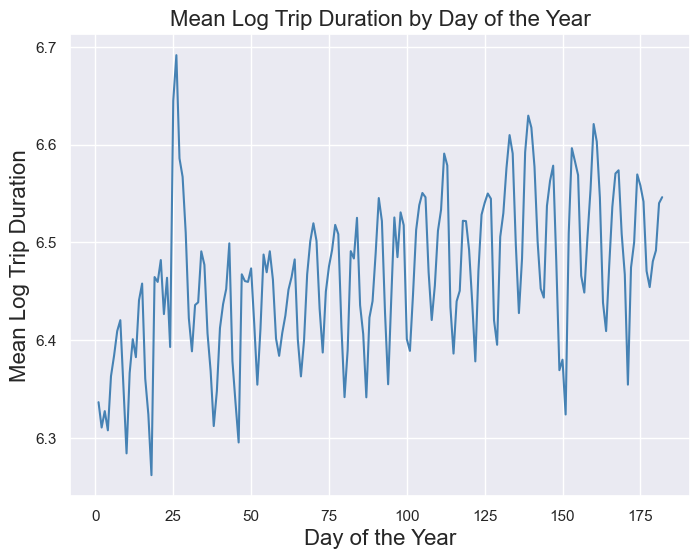

In [18]:
# Вычисление среднего логарифма времени поездки по дню в году
Train['day_of_year'] = Train['pickup_datetime'].dt.dayofyear
mean_log_duration_day = Train.groupby('day_of_year')['log_trip_duration'].mean()

# Создание графика для дня в году
plt.figure(figsize=(8, 6))
sns.lineplot(x=mean_log_duration_day.index, y=mean_log_duration_day.values, color='steelblue')

plt.xlabel('Day of the Year', fontsize=16)
plt.ylabel('Mean Log Trip Duration', fontsize=16)
plt.title('Mean Log Trip Duration by Day of the Year', fontsize=16)

plt.show()

**Вопрос**: Похожи ли графики зависимости таргета от дня недели и от часа в сутках на аналогичные графики для количества поездок? Почему? Что происходит со средним таргетом в те два аномальных периода, что мы видели выше? Почему так происходит? Наблюдаете ли вы какой-нибудь тренд на графике зависимости `log_trip_duration` от номера дня в году?

 - Графики действительно похожи, это объяснимо тем, что пизнак количество поездок сильнокоррелирован с признаком время в пути. Это логично - чем больше на дорогах машин, тем больше пробок - тем больше время в пути
 - В аномальные даты таргет имеет сильно положительное значение.
 - Заметен восходящий тренд, возможно, это объясяется тем, что в зимнее время вождить более сложно, поэтому некоторые предпочитают автобус своему транспорту.

Добавьте следующие признаки на основе `pickup_datetime`:
1. День недели
2. Месяц
3. Час
4. Является ли период аномальным (два бинарных признака, соответствующие двум аномальным периодам)
5. Номер дня в году

In [19]:
data['pickup_weekday'] = data['pickup_datetime'].dt.weekday
data['pickup_month'] = data.pickup_datetime.dt.month
data['pickup_hour'] = data['pickup_datetime'].dt.hour
data['is_anomalous_period'] = data['pickup_datetime'].apply(lambda x: 1 if x.date() in outlier_dates else 0)
data['day_of_year'] = data['pickup_datetime'].dt.dayofyear
data


,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,log_trip_duration,pickup_weekday,pickup_hour,pickup_month,is_anomalous_period,day_of_year
0,id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,6.122493,0,17,3,0,74
1,id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,6.498282,6,0,6,0,164
2,id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,7.661527,1,11,1,0,19
3,id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,6.063785,2,19,4,0,97
4,id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,6.077642,5,13,3,0,86
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1458639,id2376096,2,2016-04-08 13:31:04,4,-73.982201,40.745522,-73.994911,40.740170,N,6.658011,4,13,4,0,99
1458640,id1049543,1,2016-01-10 07:35:15,1,-74.000946,40.747379,-73.970184,40.796547,N,6.486161,6,7,1,0,10
1458641,id2304944,2,2016-04-22 06:57:41,1,-73.959129,40.768799,-74.004433,40.707371,N,6.639876,4,6,4,0,113
1458642,id2714485,1,2016-01-05 15:56:26,1,-73.982079,40.749062,-73.974632,40.757107,N,5.924256,1,15,1,0,5


In [20]:
X_train, X_test, y_train, y_test = train_test_split(data.drop(['id','log_trip_duration'],axis=1), data[['log_trip_duration']], test_size=0.3, random_state=42)

Итак, мы уже создали некоторое количество признаков.

**Вопрос**: Какие из признаков стоит рассматривать как категориальные, а какие - как численные? Почему?

**Задание 5 **. Обучите `Ridge`-регрессию с параметрами по умолчанию, закодировав все категориальные признаки с помощью `OneHotEncoder`. Численные признаки отмасштабируйте с помощью `StandardScaler`. Используйте только признаки, которые мы выделили в этой части задания.

In [21]:
X_train.columns

Index(['vendor_id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'pickup_weekday', 'pickup_hour', 'pickup_month',
       'is_anomalous_period', 'day_of_year'],
      dtype='object')

In [22]:
X_train.dtypes


vendor_id                       int64
pickup_datetime        datetime64[ns]
passenger_count                 int64
pickup_longitude              float64
pickup_latitude               float64
dropoff_longitude             float64
dropoff_latitude              float64
store_and_fwd_flag             object
pickup_weekday                  int64
pickup_hour                     int64
pickup_month                    int64
is_anomalous_period             int64
day_of_year                     int64
dtype: object

In [23]:
X_train = data.drop(['log_trip_duration','id'],axis=1)
y_train = data['log_trip_duration']


In [24]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

categorical_features = ['store_and_fwd_flag','pickup_datetime']
numeric_features = ['passenger_count', 'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'day_of_year', 'vendor_id', 'pickup_weekday', 'pickup_hour', 'pickup_month', 'is_anomalous_period']

# Создание преобразователя признаков
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_features),
        ('cat', OneHotEncoder(drop='first'), categorical_features)
    ])


model = Pipeline(steps=[('preprocessor', preprocessor),
                        ('regressor', Ridge())])

model.fit(X_train, y_train)

score = model.score(X_test,y_test)
print("R2 score:", score)

R2 score: 0.7314401346612269


## Часть 2. Изучаем координаты 
Мы уже очень хорошо изучили данные о времени начала поездки, давайте теперь посмотрим на информацию о координатах начала и конца поездки. Мы подготовили для вас функцию, которая на карте рисует точки начала или конца поездки. Примеры ее вызова вы найдете ниже. Обратите внимание, что в эту функцию мы передаем лишь небольшой кусочек данных, посколько иначе функция будет работать очень долго

In [25]:
def show_circles_on_map(data, latitude_column, longitude_column, color):
    """
    The function draws map with circles on it.
    The center of the map is the mean of coordinates passed in data.
    
    data: DataFrame that contains columns latitude_column and longitude_column
    latitude_column: string, the name of column for latitude coordinates
    longitude_column: string, the name of column for longitude coordinates
    color: string, the color of circles to be drawn
    """

    location = (data[latitude_column].mean(), data[longitude_column].mean())
    m = folium.Map(location=location)

    for _, row in data.iterrows():
        folium.Circle(
            radius=100,
            location=(row[latitude_column], row[longitude_column]),
            color=color,
            fill_color=color,
            fill=True
        ).add_to(m)

    return m

In [26]:
show_circles_on_map(data.sample(50000), "pickup_latitude", "pickup_longitude", "blue")

In [27]:
show_circles_on_map(data.sample(1000), "dropoff_latitude", "dropoff_longitude", "blue")

**Вопрос**: Какие две точки выделяются на карте?
Точка у Livingston и у Garden City

**Задание 6**. Как мы все прекрасно помним, $t = s / v_{\text{ср}}$, поэтому очевидно, что самым сильным признаком будет расстояние, которое необходимо проехать. Мы не можем посчитать точное расстояние, которое необходимо преодолеть такси, но мы можем его оценить, посчитав кратчайшее расстояние между точками начала и конца поездки. Чтобы корректно посчитать расстояние между двумя точками на Земле, можно использовать функцию `haversine`. Также можно воспользоваться кодом с первого семинара. Посчитайте кратчайшее расстояние для объектов и запишите его в колонку `haversine`:

In [28]:
from math import radians, sin, cos, sqrt, atan2

def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # Radius of the Earth in kilometers

    # Convert latitude and longitude from degrees to radians
    lat1 = radians(lat1)
    lon1 = radians(lon1)
    lat2 = radians(lat2)
    lon2 = radians(lon2)

    # Haversine formula
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * atan2(sqrt(a), sqrt(1-a))
    distance = R * c

    return distance

data['haversine'] = data.apply(lambda row: haversine(row['pickup_latitude'], row['pickup_longitude'], row['dropoff_latitude'], row['dropoff_longitude']), axis=1)

Так как мы предсказываем логарифм времени поездки и хотим, чтобы наши признаки были линейно зависимы с этой целевой переменной, нам нужно логарифмировать расстояние: $\log t = \log s - \log{v_{\text{ср}}}$. Запишите логарифм `haversine` в отдельную колонку:

In [29]:
data['log_haversine'] = np.log1p(data['haversine'])
data

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,log_trip_duration,pickup_weekday,pickup_hour,pickup_month,is_anomalous_period,day_of_year,haversine,log_haversine
0,id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,6.122493,0,17,3,0,74,1.498521,0.915699
1,id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,6.498282,6,0,6,0,164,1.805507,1.031584
2,id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,7.661527,1,11,1,0,19,6.385098,1.999464
3,id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,6.063785,2,19,4,0,97,1.485498,0.910473
4,id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,6.077642,5,13,3,0,86,1.188588,0.783257
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1458639,id2376096,2,2016-04-08 13:31:04,4,-73.982201,40.745522,-73.994911,40.740170,N,6.658011,4,13,4,0,99,1.225080,0.799793
1458640,id1049543,1,2016-01-10 07:35:15,1,-74.000946,40.747379,-73.970184,40.796547,N,6.486161,6,7,1,0,10,6.049836,1.953004
1458641,id2304944,2,2016-04-22 06:57:41,1,-73.959129,40.768799,-74.004433,40.707371,N,6.639876,4,6,4,0,113,7.824606,2.177544
1458642,id2714485,1,2016-01-05 15:56:26,1,-73.982079,40.749062,-73.974632,40.757107,N,5.924256,1,15,1,0,5,1.092564,0.738390


Убедимся, что логарифм расстояния лучше коррелирует с нашим таргетом, чем просто расстояние:

In [30]:
print("Correlation between haversine and log_trip_duration: ", data['haversine'].corr(data['log_trip_duration']))
print("Correlation between log_haversine and log_trip_duration: ", data['log_haversine'].corr(data['log_trip_duration']))

Correlation between haversine and log_trip_duration:  0.5735948311180159
Correlation between log_haversine and log_trip_duration:  0.7498822373942502


**Задание 7**. Давайте изучим среднюю скорость движения такси. Посчитайте среднюю скорость для каждого объекта обучающей выборки, разделив `haversine` на `trip_duration`, и нарисуйте гистограмму ее распределения

In [31]:
data['avr_speed'] = data.apply(lambda row: row['haversine']*3600/np.expm1(row['log_trip_duration']), axis=1)

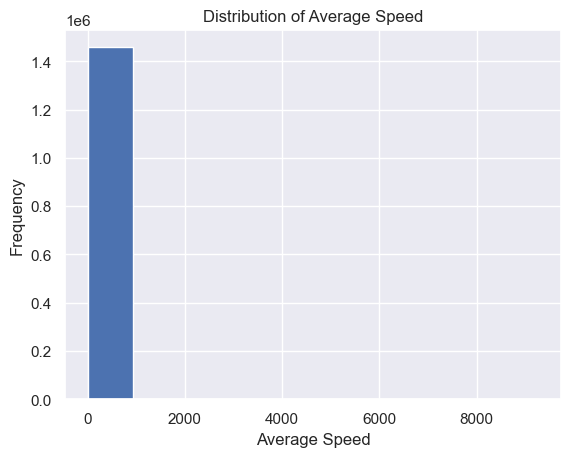

In [32]:
plt.hist(data['avr_speed'], bins=10)
plt.xlabel('Average Speed')
plt.ylabel('Frequency')
plt.title('Distribution of Average Speed')
plt.show()

Как можно видеть по гистограмме, для некоторых объектов у нас получились очень больше значения скоростей. Нарисуйте гистограмму по объектам, для которых значение скорости получилось разумным (например, можно не включать рассмотрение объекты, где скорость больше некоторой квантили):

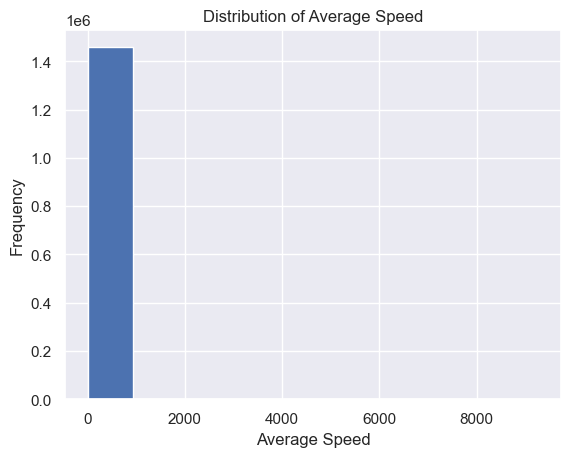

In [33]:
plt.hist(data['avr_speed'], bins=10)
plt.xlabel('Average Speed')
plt.ylabel('Frequency')
plt.title('Distribution of Average Speed')
plt.show()

Для каждой пары (день недели, час суток) посчитайте медиану скоростей. Нарисуйте с помощью `sns.heatmap` график, где по осям будут дни недели и часы, а в качестве значения функции - медиана скорости

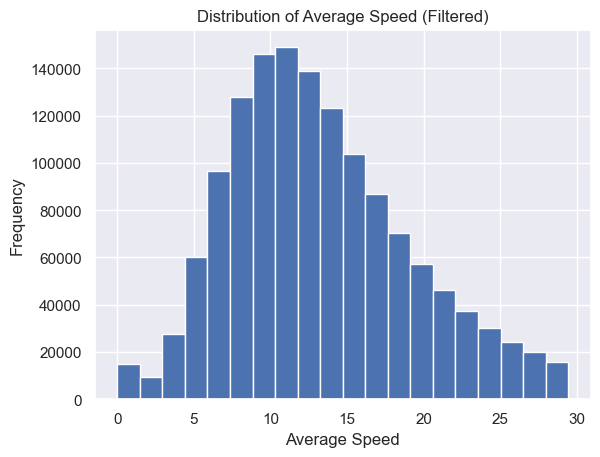

In [34]:
filtered_data = data[data['avr_speed'] <= np.quantile(data['avr_speed'], 0.95)]

# Create histogram of the filtered speed values
plt.hist(filtered_data['avr_speed'], bins=20)
plt.xlabel('Average Speed')
plt.ylabel('Frequency')
plt.title('Distribution of Average Speed (Filtered)')
plt.show()

Не забудьте удалить колонку со значением скорости из данных!

**Вопрос**: Почему значение скорости нельзя использовать во время обучения?

Значение скорости или любая производная функция, которая непосредственно включает целевую переменную (в данном случае продолжительность поездки), не должны использоваться в процессе обучения. Включение целевой переменной или любой информации, непосредственно полученной из нее, в качестве функции может привести к переобучению и ненадежной работе модели.


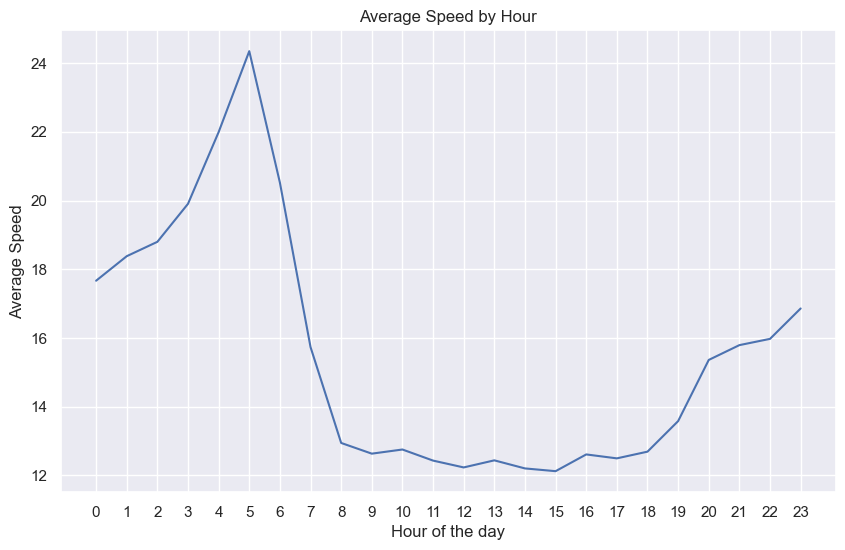

In [35]:
import matplotlib.pyplot as plt

average_speed_by_hour = data.groupby('pickup_hour')['avr_speed'].mean()

plt.figure(figsize=(10, 6))
plt.plot(average_speed_by_hour.index, average_speed_by_hour.values)
plt.xlabel('Hour of the day')
plt.ylabel('Average Speed')
plt.title('Average Speed by Hour')
plt.grid(True)
plt.xticks(range(24))

plt.show()


In [36]:
data.drop(['avr_speed'],axis=1,inplace=True)

**Вопрос**: Посмотрите внимательно на график и скажите, в какие моменты времени скорость минимальна; максимальна.

Создайте признаки "поездка совершается в период пробок" и "поездка совершается в период свободных дорог" (естественно, они не должен зависеть от скорости!):

In [37]:
data['Rush Hour'] = ((data['pickup_hour'] > 6) & (data['pickup_hour'] <20))

data['Free Flow'] = (((data['pickup_hour'] >= 20) | (data['pickup_hour'] <= 6)))


In [38]:
data

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,log_trip_duration,pickup_weekday,pickup_hour,pickup_month,is_anomalous_period,day_of_year,haversine,log_haversine,Rush Hour,Free Flow
0,id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,6.122493,0,17,3,0,74,1.498521,0.915699,True,False
1,id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,6.498282,6,0,6,0,164,1.805507,1.031584,False,True
2,id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,7.661527,1,11,1,0,19,6.385098,1.999464,True,False
3,id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,6.063785,2,19,4,0,97,1.485498,0.910473,True,False
4,id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,6.077642,5,13,3,0,86,1.188588,0.783257,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1458639,id2376096,2,2016-04-08 13:31:04,4,-73.982201,40.745522,-73.994911,40.740170,N,6.658011,4,13,4,0,99,1.225080,0.799793,True,False
1458640,id1049543,1,2016-01-10 07:35:15,1,-74.000946,40.747379,-73.970184,40.796547,N,6.486161,6,7,1,0,10,6.049836,1.953004,True,False
1458641,id2304944,2,2016-04-22 06:57:41,1,-73.959129,40.768799,-74.004433,40.707371,N,6.639876,4,6,4,0,113,7.824606,2.177544,False,True
1458642,id2714485,1,2016-01-05 15:56:26,1,-73.982079,40.749062,-73.974632,40.757107,N,5.924256,1,15,1,0,5,1.092564,0.738390,True,False


**Задание 8**. Как уже было замечено выше, на карте выделяются две точки вдали от Манхэттена. Для каждой из них добавьте в выборку два признака: началась ли поездка в ней и закончилась ли она в ней.

In [39]:
manhattan_latitude = 40.7831
manhattan_longitude = -73.9712

# Calculate the distance between each trip's start and end points and Manhattan
data['distance_to_manhattan_start'] = np.sqrt(
    np.square(data['pickup_latitude'] - manhattan_latitude) +
    np.square(data['pickup_longitude'] - manhattan_longitude)
)
data['distance_to_manhattan_end'] = np.sqrt(
    np.square(data['dropoff_latitude'] - manhattan_latitude) +
    np.square(data['dropoff_longitude'] - manhattan_longitude)
)

# Sort the data by distance to Manhattan in descending order
data_sorted_start = data.sort_values('distance_to_manhattan_start', ascending=False)
data_sorted_end = data.sort_values('distance_to_manhattan_end', ascending=False)

# Get the coordinates of the two farthest points from Manhattan
farthest_point1_start_latitude = data_sorted_start.iloc[0]['pickup_latitude']
farthest_point1_start_longitude = data_sorted_start.iloc[0]['pickup_longitude']
farthest_point2_start_latitude = data_sorted_start.iloc[1]['pickup_latitude']
farthest_point2_start_longitude = data_sorted_start.iloc[1]['pickup_longitude']

farthest_point1_end_latitude = data_sorted_end.iloc[0]['dropoff_latitude']
farthest_point1_end_longitude = data_sorted_end.iloc[0]['dropoff_longitude']
farthest_point2_end_latitude = data_sorted_end.iloc[1]['dropoff_latitude']
farthest_point2_end_longitude = data_sorted_end.iloc[1]['dropoff_longitude']

# Add features indicating if the trip started or ended at the farthest points from Manhattan
data['start_at_point1'] = ((abs(data['pickup_latitude'] - farthest_point1_start_latitude)<10) & (abs(data['pickup_longitude'] - farthest_point1_start_longitude)<10)).astype(int)
data['end_at_point1'] = ((abs(data['dropoff_latitude'] - farthest_point1_end_latitude)<10) & (abs(data['dropoff_longitude'] - farthest_point1_end_longitude)<10)).astype(int)

data['start_at_point2'] = ((abs(data['pickup_latitude'] - farthest_point2_start_latitude)<10) & (abs(data['pickup_longitude'] - farthest_point2_start_longitude)<10)).astype(int)
data['end_at_point2'] = ((abs(data['dropoff_latitude'] - farthest_point2_end_latitude)<10) & (abs(data['dropoff_longitude'] - farthest_point2_end_longitude)<10)).astype(int)


Для каждого из созданных признаков нарисуйте "ящик с усами" (`sns.boxplot`) распределения логарифма времени поездки

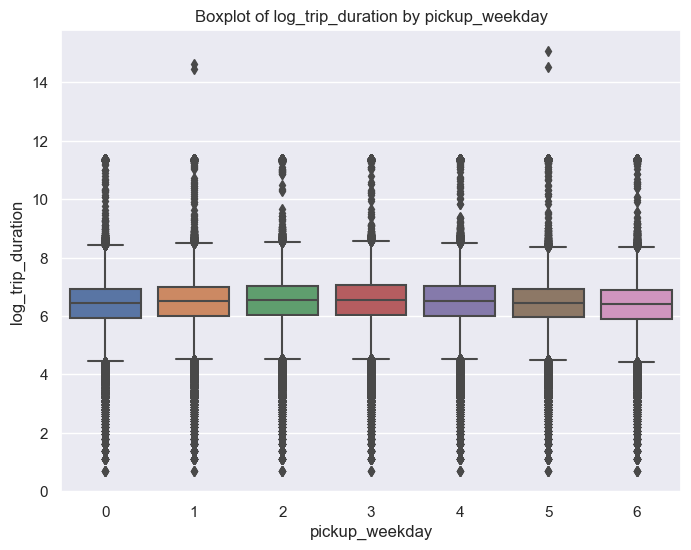

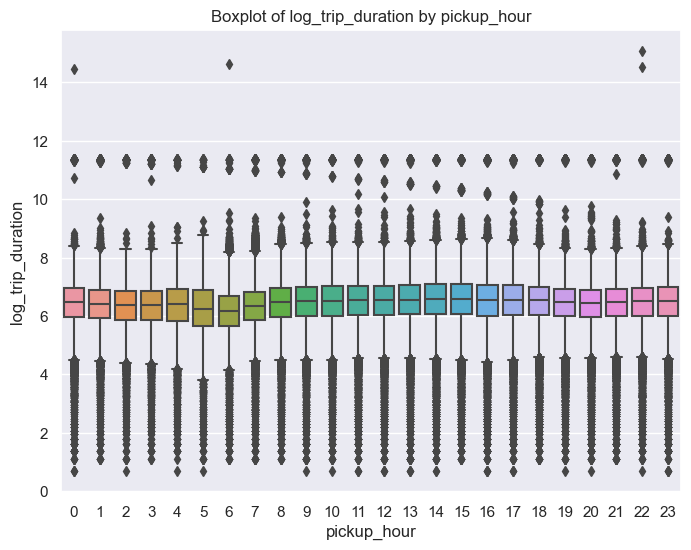

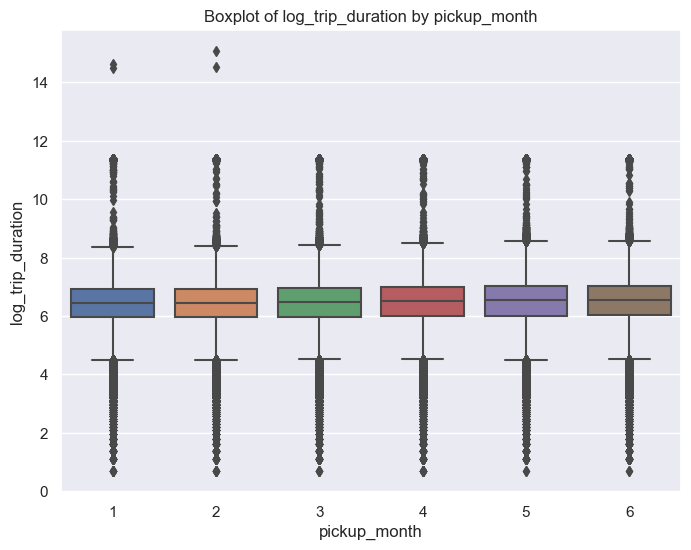

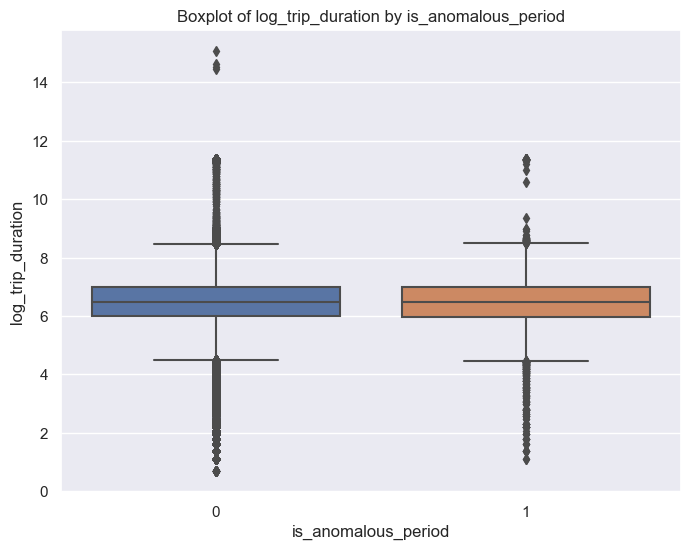

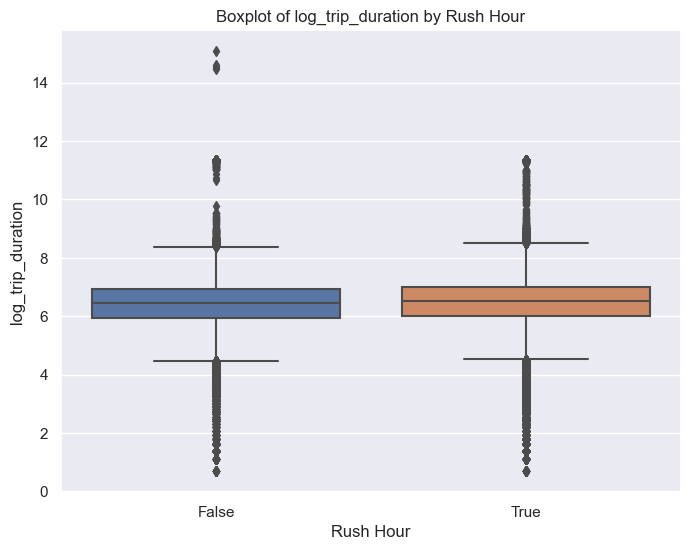

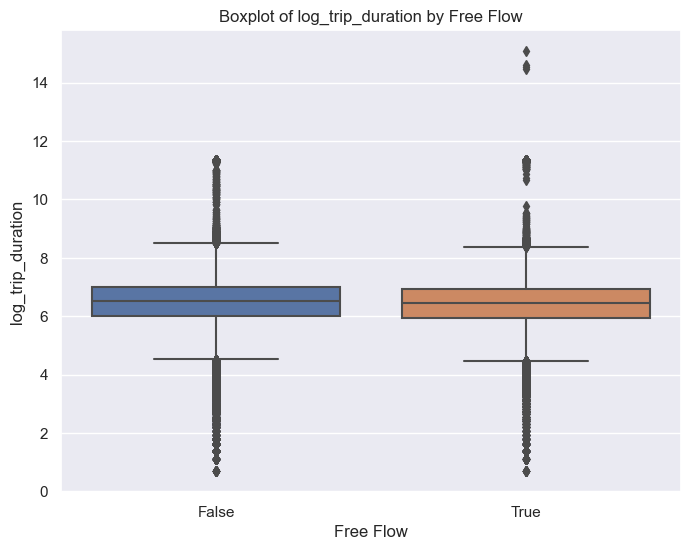

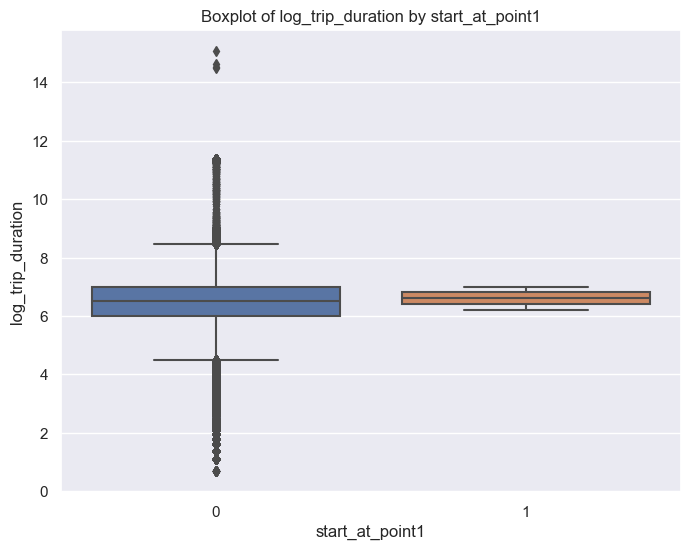

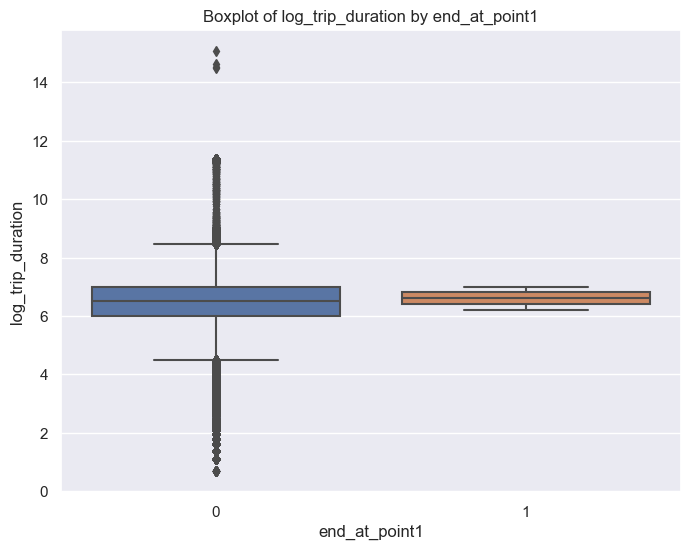

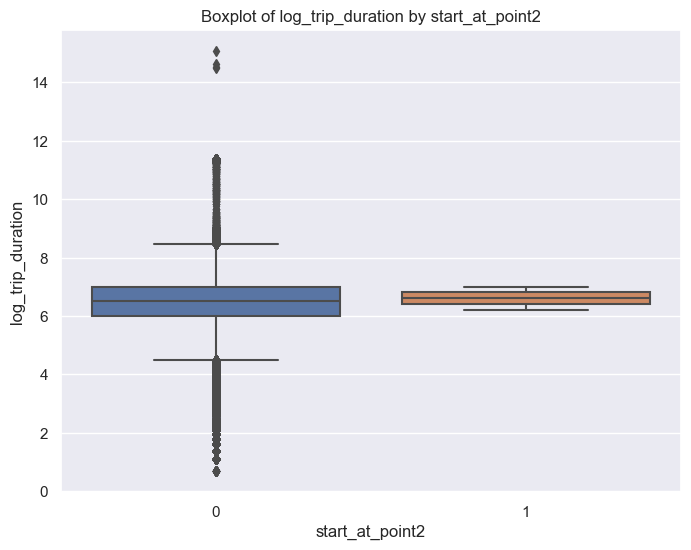

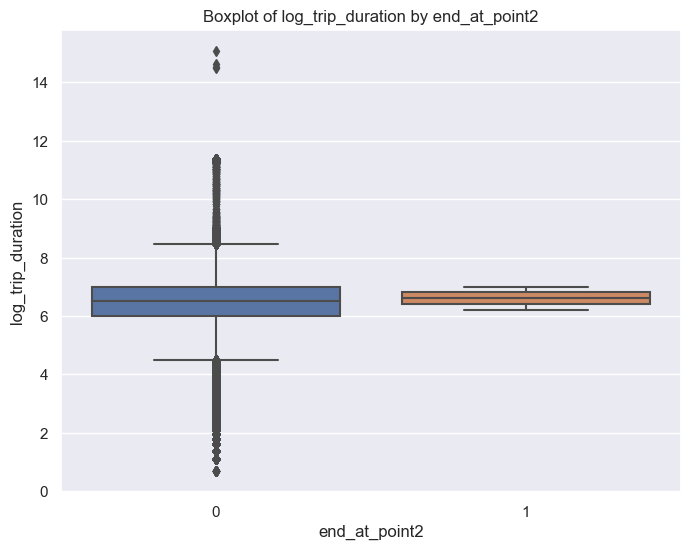

In [40]:
import seaborn as sns
import matplotlib.pyplot as plt

# List of attributes to plot
attributes = ['pickup_weekday', 'pickup_hour', 'pickup_month', 'is_anomalous_period', 'Rush Hour', 'Free Flow',  'start_at_point1', 'end_at_point1', 'start_at_point2', 'end_at_point2']

# Plot boxplots for each attribute
for attribute in attributes:
    plt.figure(figsize=(8, 6))
    sns.boxplot(x=data[attribute], y=data['log_trip_duration'])
    plt.title(f"Boxplot of log_trip_duration by {attribute}")
    plt.xlabel(attribute)
    plt.ylabel("log_trip_duration")
    plt.show()

**Вопрос**: судя по графикам, как вы думаете, хорошими ли получились эти признаки?
Признаки получились достаточно хорошими, однако есть выбросы в данных.

<img src="https://www.dropbox.com/s/xson9nukz5hba7c/map.png?raw=1" align="right" width="20%" style="margin-left: 20px; margin-bottom: 20px">

**Задание 9**. Сейчас мы почти что не используем сами значения координат. На это есть несколько причин: по отдельности рассматривать широту и долготу не имеет особого смысла, стоит рассматривать их вместе. Во-вторых, понятно, что зависимость между нашим таргетом и координатами не линейная. Чтобы как-то использовать координаты, можно прибегнуть к следующему трюку: обрамим область с наибольшим количеством поездок прямоугольником (как на рисунке). Разобьем этот прямоугольник на ячейки. Каждой точке сопоставим номер ее ячейки, а тем точкам, что не попали ни в одну из ячеек, сопоставим значение -1.

Напишите трансформер, который сначала разбивает показанную на рисунке область на ячейки, а затем создает два признака: номер ячейки, в которой началась поездка, и номер ячейки, в которой закончилась поездка. Количество строк и столбцов выберите самостоятельно.

Обратите внимание, что все вычисления должны быть векторизованными, трансформер не должен модифицировать передаваемую ему выборку inplace, а все необходимые статистики (если они вдруг нужны) нужно считать только по обучающей выборке в методе `fit`:

In [41]:
from sklearn.base import BaseEstimator, TransformerMixin

class MapGridTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, num_rows, num_cols, latitude_range, longitude_range):
        self.num_rows = num_rows
        self.num_cols = num_cols
        self.latitude_range = latitude_range
        self.longitude_range = longitude_range
        
    def fit(self, X=None, y=None):
        return self
    
    def transform(self, X, y=None):
        X_transformed = X.copy()
        
        # Calculate the width and height of each cell
        lat_step = (self.latitude_range[1] - self.latitude_range[0]) / self.num_rows
        lon_step = (self.longitude_range[1] - self.longitude_range[0]) / self.num_cols
        X_transformed['start_cell'] = self._get_cell_number(X_transformed['pickup_latitude'], X_transformed['pickup_longitude'], lat_step, lon_step)
        X_transformed['end_cell'] = self._get_cell_number(X_transformed['dropoff_latitude'], X_transformed['dropoff_longitude'], lat_step, lon_step)
        
        return X_transformed
    
    def _get_cell_number(self, latitude, longitude, lat_step, lon_step):
        row_idx = ((latitude - self.latitude_range[0]) / lat_step).astype(int)
        col_idx = ((longitude - self.longitude_range[0]) / lon_step).astype(int)
        cell_number = row_idx * self.num_cols + col_idx
        cell_number[(row_idx < 0) | (row_idx >= self.num_rows) | (col_idx < 0) | (col_idx >= self.num_cols)] = -1
        
        return cell_number


In [42]:

grid_transformer = MapGridTransformer(num_rows=10, num_cols=10, latitude_range=(40.6, 40.9), longitude_range=(-74.1, -73.8))

data = grid_transformer.fit_transform(data)

data

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,log_trip_duration,...,Rush Hour,Free Flow,distance_to_manhattan_start,distance_to_manhattan_end,start_at_point1,end_at_point1,start_at_point2,end_at_point2,start_cell,end_cell
0,id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,6.122493,...,True,False,0.018707,0.018691,0,0,0,0,53,54
1,id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,6.498282,...,False,True,0.045480,0.059148,0,0,0,0,43,43
2,id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,7.661527,...,True,False,0.020698,0.080598,0,0,0,0,54,33
3,id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,6.063785,...,True,False,0.074121,0.086722,0,0,0,0,32,32
4,id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,6.077642,...,True,False,0.010277,0.001818,0,0,0,0,64,64
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1458639,id2376096,2,2016-04-08 13:31:04,4,-73.982201,40.745522,-73.994911,40.740170,N,6.658011,...,True,False,0.039156,0.049043,0,0,0,0,43,43
1458640,id1049543,1,2016-01-10 07:35:15,1,-74.000946,40.747379,-73.970184,40.796547,N,6.486161,...,True,False,0.046484,0.013485,0,0,0,0,43,64
1458641,id2304944,2,2016-04-22 06:57:41,1,-73.959129,40.768799,-74.004433,40.707371,N,6.639876,...,False,True,0.018714,0.082700,0,0,0,0,54,33
1458642,id2714485,1,2016-01-05 15:56:26,1,-73.982079,40.749062,-73.974632,40.757107,N,5.924256,...,True,False,0.035735,0.026219,0,0,0,0,43,54


**Задание 10 (0.25 балла)**. Обучите `Ridge`-регрессию со стандартными параметрами на признаках, которые мы выделили к текущему моменту. Категориальные признаки закодируйте через one-hot-кодирование, числовые признаки отмасштабируйте.

In [43]:
X_train, X_test, y_train, y_test = train_test_split(data.drop(['id','haversine','log_trip_duration'],axis=1), data[['log_trip_duration']], test_size=0.3, random_state=42)

MemoryError: Unable to allocate 23.4 MiB for an array with shape (7, 437594) and data type float64

In [ ]:
X_train.columns

Index(['vendor_id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'store_and_fwd_flag', 'pickup_weekday', 'pickup_hour', 'pickup_month',
       'is_anomalous_period', 'day_of_year', 'log_haversine', 'Rush Hour',
       'Free Flow', 'distance_to_manhattan_start', 'distance_to_manhattan_end',
       'start_at_point1', 'end_at_point1', 'start_at_point2', 'end_at_point2',
       'start_cell', 'end_cell'],
      dtype='object')

In [ ]:
X_train.dtypes

vendor_id                               int64
pickup_datetime                datetime64[ns]
passenger_count                         int64
pickup_longitude                      float64
pickup_latitude                       float64
dropoff_longitude                     float64
dropoff_latitude                      float64
store_and_fwd_flag                     object
pickup_weekday                          int64
pickup_hour                             int64
pickup_month                            int64
is_anomalous_period                     int64
day_of_year                             int64
log_haversine                         float64
Rush Hour                                bool
Free Flow                                bool
distance_to_manhattan_start           float64
distance_to_manhattan_end             float64
start_at_point1                         int32
end_at_point1                           int32
start_at_point2                         int32
end_at_point2                     

In [ ]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

categorical_vars = ['vendor_id', 'store_and_fwd_flag', 'pickup_weekday', 'pickup_hour', 'pickup_month', 'is_anomalous_period', 'Rush Hour', 'Free Flow', 'start_at_point1', 'end_at_point1', 'start_at_point2', 'end_at_point2', 'start_cell', 'end_cell']
numerical_vars = ['passenger_count', 'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'day_of_year', 'log_haversine', 'distance_to_manhattan_start', 'distance_to_manhattan_end']


# Создание преобразователя признаков
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_features),
        ('cat', OneHotEncoder(drop='first'), categorical_features)
    ])


model = Pipeline(steps=[('preprocessor', preprocessor),
                        ('regressor', Ridge())])

model.fit(X_train, y_train)

score = model.score(X_test,y_test)
print("R2 score:", score)

NameError: name 'numeric_features' is not defined

## Часть 3. Изучаем оставшиеся признаки (1 балл)

**Задание 11**. У нас осталось еще 3 признака, которые мы не исследовали: `vendor_id`, `passenger_count` и `store_and_fwd_flag`.

**Вопрос**: Подумайте, почему каждый из этих признаков может быть потенциально полезным.

Посчитайте, сколько есть уникальных значений у каждого из этих признаков:

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Постройте "ящики с усами" распределений логарифма времени поездки в зависимости от значений каждого из признаков

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Переведите признаки `vendor_id` и `store_and_fwd_flag` в значения $\{0;1\}$

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

**Вопрос**: Основываясь на графиках выше, как вы думаете, будут ли эти признаки сильными?

**Задание 12**. Проверьте свои предположения, обучив модель в том числе и на этих трех признаках. Обучайте `Ridge`-регрессию со стандартными параметрами. Категориальные признаки закодируйте one-hot-кодированием, а численные отмасштабируйте.

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Если признаки не дали какого-то ощутимого улучшения метрики, их можно выбросить из данных.

## Часть 4. Улучшаем модель

**Задание 13**. В наших данных есть нетипичные объекты: с аномально маленьким времени поездки, с очень большим пройденным расстоянием или очень большими остатками регрессии. В этом задании предлагается исключить такие объекты из обучающей выборки. Для этого нарисуйте гистограммы распределения упомянутых выше величин, выберите объекты, которые можно назвать выбросами, и очистите обучающую выборку от них.

Отметим, что хотя эти объекты и выглядят как выбросы, в тестовой выборке тоже скорее всего будут объекты с такими же странными значениями целевой переменной и/или признаков. Поэтому, возможно, чистка обучающей выборки приведёт к ухудшению качества на тесте. Тем не менее, всё равно лучше удалять выбросы из обучения, чтобы модель получалась более разумной и интерпретируемой.

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Сейчас у нас очень много категориальных признаков. В категориальных признаках могут содержаться редкие категории, обычно это плохо: модель сильно переобучается на таких примерах. Попробуйте объединить редкие категории в одну. Естественно, делать это нужно только для действительно редких категорий.

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Обучите модель на очищенных данных и посчитайте качество на тестовой выборке.

**Задание 14**. После OneHot-кодирования количество признаков в нашем датасете сильно возрастает. Посчитайте колиество признаков до и после кодирования категориальных признаков.

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Попробуйте обучить не `Ridge`-, а `Lasso`-регрессию. Какой метод лучше?

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Разбейте обучающую выборку на обучающую и валидационную в отношении 8:2. По валидационной выборке подберите оптимальные значения параметра регуляризации (по логарифмической сетке) для `Ridge` и `Lasso`, на тестовой выборке измерьте качество лучшей полученной модели.

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Для каждого перебранного `alpha` для Lasso посчитайте количество нулевых весов в модели и нарисуйте график зависимости его от `alpha`. Как сильно придётся потерять в качестве, если мы хотим с помощью Lasso избавиться хотя бы от половины признаков?

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

<img src="https://www.dropbox.com/s/wp4jj0599np17lh/map_direction.png?raw=1" width="20%" align="right" style="margin-left: 20px">

**Задание 15**. Часто бывает полезным использовать взаимодействия признаков (feature interactions), то есть строить новые признаки на основе уже существующих. Выше мы разбили карту Манхэттена на ячейки и придумали признаки "из какой ячейки началась поездка" и "в какой ячейке закончилась поездка".

Давайте попробуем сделать следующее: посчитаем, сколько раз встречается каждая возможная пара этих признаков в нашем датасете и выберем 100 самых частых пар. Закодируем поездки с этими частыми парами как категориальный признак, остальным объектам припишем -1. Получается, что мы закодировали, откуда и куда должно было ехать такси.

Также можете придумать ещё какой-нибудь способ сделать признаки про маршрут. Если эти признаки будут давать хороший прирост в качестве, то за это могут быть даны дополнительные бонусные баллы.

**Вопрос**: Почему такой признак потенциально полезный? Почему линейная модель не может самостоятельно "вытащить" эту информацию, ведь у нее в распоряжении есть признаки "из какой ячейки началась поездка" и "в какой ячейке закончилась поездка"?

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Заново обучите модель (`Ridge`, если она дала более высокое качество в предыдущих экспериментах, и `Lasso` иначе) на новых даннных и посчитайте качество на тестовой выборке

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

**Задание 16 (бонус)**. Где, как не для нашей задачи, считать манхэттенское расстояние?

**Вопрос**: Найдите, что такое манхэттенское расстояние и почему оно так называется. Как оно нам может помочь?

Введите систему координат на нашей карте так, чтобы оси были параллельны улицам Манхэттена, и добавьте сначала в данные признак "манхэттенское расстояние между пунктом отправления и пунктом назначения", а затем и логарифм этого признака. Посчитайте корреляцию между вашим новыми признаком и таргетом; между `log_haversine` и таргетом. В каком случае корреляция больше?

Нарисуйте карту, где покажете выбранные оси. Чтобы мы могли проверить вашу работу, просьба сделать скрин этой карты и приложить картинку (если мы откроем ваш ноутбук, виджеты отображаться не будут). 

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

Заново обучите модель на новых даннных и посчитайте качество на тестовой выборке. Стало ли лучше? Объясните полученный результат.

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ

**Задание 17 (бонус)**. Реализуйте трансформер, который строит разбиение карты по шестигранной решётке с помощью библиотеки [H3](https://github.com/uber/h3-py) и вычисляет признаки на основе такого разбиения.

Признаки могут быть самые разные: расстояние между точкой старта и финиша, посчитанное в количестве шестиугольников; статистика по числу поездок и по их продолжительности в соседних шестиугольниках.

Важно: производительность библиотеки существенно зависит от количества шестиугольников на карте (определяется параметром resolution). Подберите такое разрешение, при котором ваш код будет работать за приемлемое время.

При построении признаков старайтесь не допустить утечки целевой переменной (подробнее про это можно почитать в материалах 1-го семинара) — в противном случае хорошего качества на тестовой выборке достичь не получится.

Измерьте качество после добавления новых признаков. За улучшение функционала ошибки на каждые 0.005 на тестовой выборке будет даваться 0.5 бонусных балла. Можно получить до 2 бонусных баллов за это задание.

In [ ]:
#╰( ͡° ͜ʖ ͡° )つ──☆*:・ﾟ